 # Simple clustering of larvae sc-RNAseq

In [1]:
from graspologic.utils.utils import is_fully_connected
import numpy as np
import pandas as pd
# import scanpy as sc

from graspologic.embed.ase import AdjacencySpectralEmbed
from graspologic.embed.lse import LaplacianSpectralEmbed
from graspologic.embed import select_dimension
from graspologic.utils import is_symmetric, is_unweighted, largest_connected_component
from graspologic.utils import symmetrize, is_fully_connected
from graspologic.plot import pairplot
from graspologic.cluster import AutoGMMCluster, autogmm

from sklearn.metrics import adjusted_rand_score, pairwise_kernels
from sklearn.metrics.pairwise import euclidean_distances
# from sklearn.decomposition import PCA
from sklearn.preprocessing import normalize
from sklearn.neighbors import kneighbors_graph
from sklearn.preprocessing import normalize
from sklearn.cluster import SpectralClustering
from sklearn.utils.extmath import density

from math import dist
from scipy.stats import spearmanr, kendalltau
import os
from itertools import combinations
from scipy.io import mmread
import matplotlib.pyplot as plt
import seaborn as sns
import random

context = sns.plotting_context(context="talk", font_scale=0.8)
sns.set_context(context)


 ## import intermediate results from R

In [2]:
# sample R code
# s1.data <- Read10X("10X_data/Sample_1_SI-GA-A1_count_Sample_1/filtered_feature_bc_matrix")
# s1 <- CreateSeuratObject(counts = s1.data, project = "Sample_1", min.cells = 3,  min.features = 200)
# s1 <- RenameCells(object = s1, add.cell.id = "s1")

# s1[["percent.mt"]] <- PercentageFeatureSet(s1, pattern = "^mt:")
# s1 <- CellCycleScoring(s1, g2m.features = g2m_genes, s.features = s_genes)

# The input count matrix (gene by cell) contains zeros that either mean 
# no or undetectable expression. However, there is no way to differentiate them.
# Hence, we are using the raw count matrix (instead of extracting
# detectable genes) for now and performing the following normalization.

# Use regularized negative binomial regression to normalize UMI
# https://github.com/ChristophH/sctransform
# s1 <- SCTransform(s1, vars.to.regress = "percent.mt")

# save the Pearson residuals
# residuals <- t(s1[['SCT']]@scale.data)
# write.table(residuals, 's1/residuals.csv', sep = ',', quote = F)


In [3]:
sample_id = 's1'
SCT_residuals = pd.read_csv("Brainseq/"+sample_id+"/residuals.csv", index_col=0)
residuals = SCT_residuals.to_numpy()


 ## construct graph adjacency matrix

In [4]:
dist_mat = euclidean_distances(residuals)

# rescale distances into [0,1] and convert to adjacency matrix
adj_scale = 1 - dist_mat / dist_mat.max()

# or use a kernel to make adjacency matrix
delta = np.std(dist_mat.flatten()) * 5  # tentatively using 5 after some tuning
adj_rbf = np.exp(- dist_mat ** 2 / (2. * delta ** 2))

# or try kNN graph
adj_knn = kneighbors_graph(dist_mat, n_neighbors=15, include_self=True)
adj_knn = symmetrize(adj_knn.toarray())


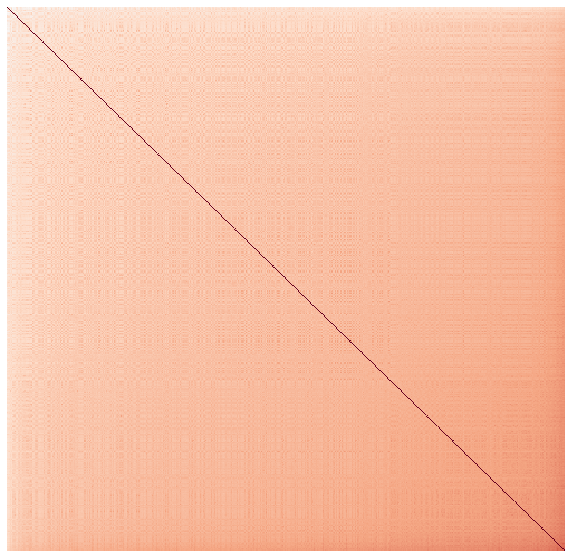

In [5]:
# plot heatmap of the graph (or a random subgraph if graph is too large)

adj = adj_scale.copy()
idx = np.argsort(np.sum(adj, axis=0))
len_subplot = 500
subset = random.sample(range(len(adj)), len_subplot)
idx = idx[np.sort(subset)]
adj_sorted = adj[idx] [:,idx]
fig, ax = plt.subplots(1, figsize=(10,10))
sns.heatmap(adj_sorted, cmap="RdBu_r", center=0, cbar=False, ax=ax, xticklabels='', yticklabels='')
plt.show()


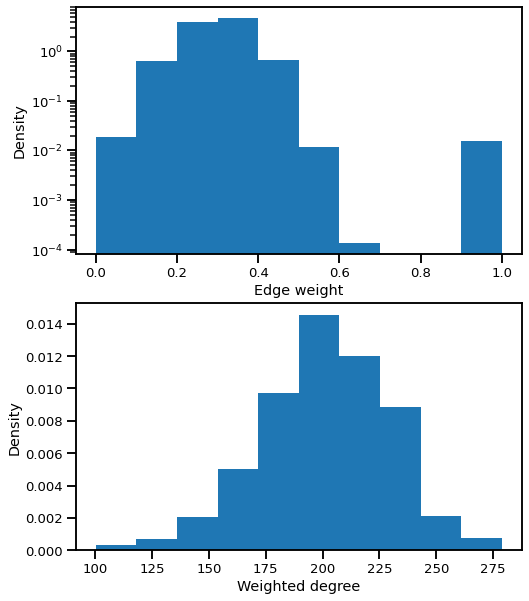

In [6]:
# check if graph is fully connected
if not is_fully_connected(adj):
    adj = largest_connected_component(adj)

fig, axs = plt.subplots(2,1, figsize=(8,10))
ax = axs[0]
ax.hist(adj.flatten(), log=True, density=True)
ax.set(xlabel='Edge weight', ylabel='Density')
ax = axs[1]
ax.hist(np.sum(adj, axis=0), density=True)
ax.set(xlabel='Weighted degree', ylabel='Density')
plt.show()


 ## spectral embedding

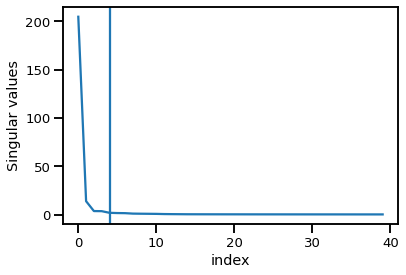

In [8]:
ase = AdjacencySpectralEmbed(40)
ase.fit(adj)
singular_values = ase.singular_values_
fig,ax = plt.subplots(1)
ax.plot(range(len(singular_values)), singular_values)

ase = AdjacencySpectralEmbed(n_elbows=3)
embedding = ase.fit_transform(adj)
ax.axvline(embedding.shape[1])
ax.set(xlabel='index', ylabel='Singular values')
plt.show()


 ## visualize marker genes' expression levels for different cell types
 ## on the embeddings

In [9]:
feature_id = {}

feature_names_all = [
    ["brp","nSyb","elav","Syt1","CadN","jeb","IA-2","Rdl","nrv-3","VGlut","VAChT",
     "Gad1","Vmat","jim","myr-GFP-p10","nls-tdTomato"],  # neuron
    ["repo", "hoe1","swim","vir-1","wrapper","alrm","Eaat1","Gat","Gs30","MFS9",
     "bnb","sli"],  # glia
    ["N","dpn","Pen","mira","Grh","Kr"],  # NPCs
    # ["hdc","unk","sn","pho"],  # adult neurons
]
for i in range(len(feature_names_all)):
    feature_id[i] = []
    for j in feature_names_all[i]:
        try:
            feature_id[i].append(SCT_residuals.T.index.get_loc(j))
        except:
            continue
colors = ['Reds', 'Blues', 'Purples']
cell_types = ['neuron', 'glia', 'NPC']
n_dim = embedding.shape[1]


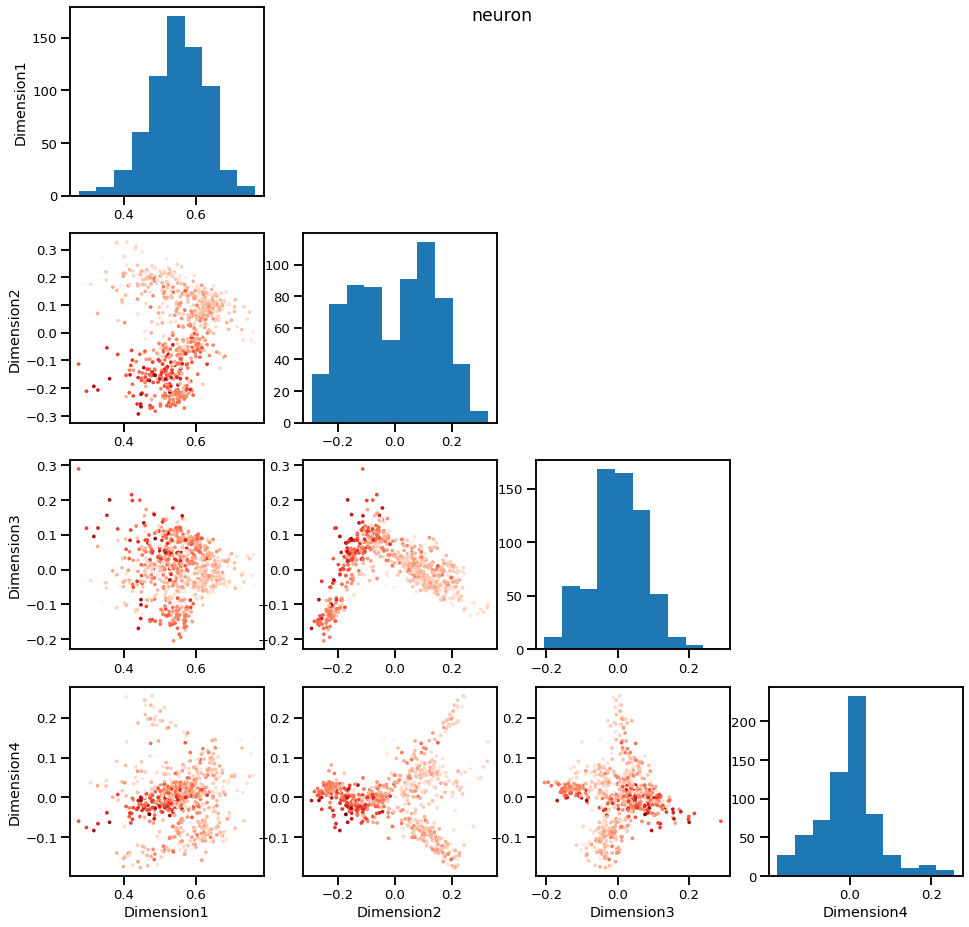

In [10]:
cell_type_id = 0
expn = np.sum(residuals[:,feature_id[cell_type_id]], axis=1)

fig,axs = plt.subplots(n_dim, n_dim,figsize=(n_dim*4, n_dim*4))
for i in range(n_dim):
    for j in range(n_dim):
        ax = axs[i,j]
        if j > i:
            ax.axis('off')
        else:
            if j == i:
                ax.hist(embedding[:,i])
            else:
                ax.scatter(embedding[:,j], embedding[:,i], s=5, cmap=colors[cell_type_id],
                    c=expn)
            if i == n_dim - 1:
                ax.set_xlabel('Dimension'+str(j+1))
            if j == 0:
                ax.set_ylabel('Dimension'+str(i+1))
plt.suptitle(cell_types[cell_type_id], y=0.88)
plt.show()


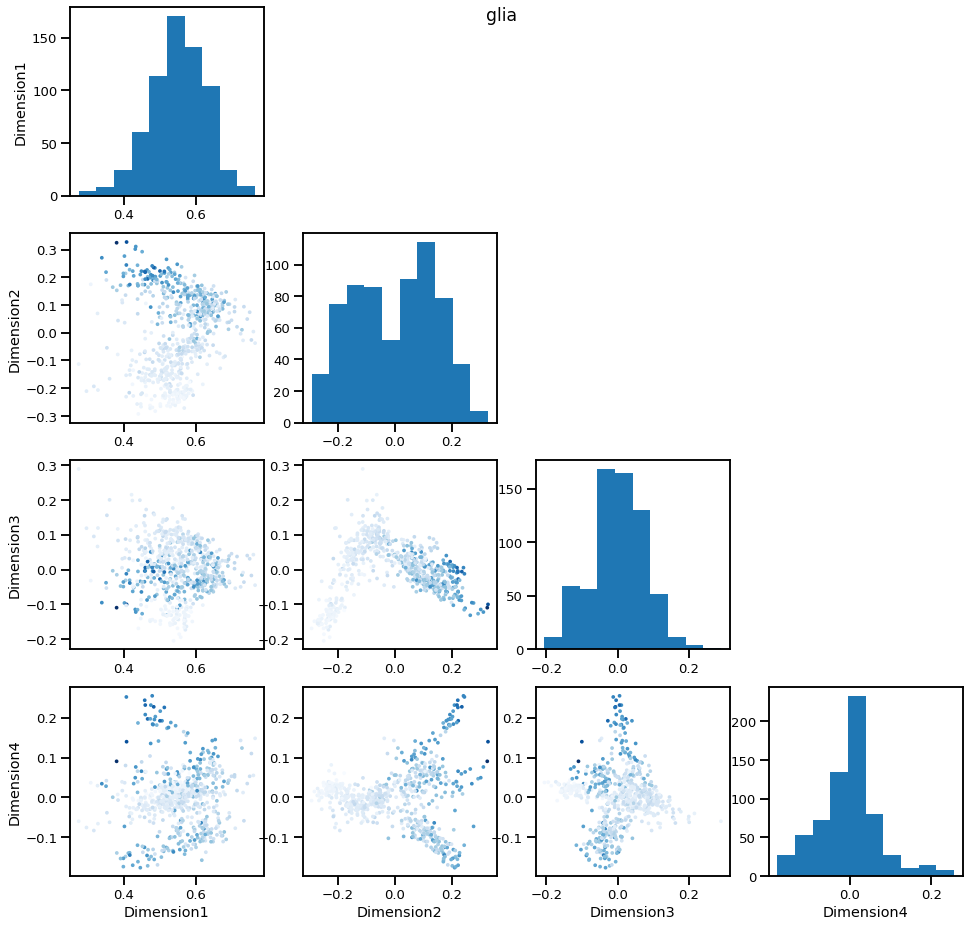

In [11]:
cell_type_id = 1
expn = np.sum(residuals[:,feature_id[cell_type_id]], axis=1)

fig,axs = plt.subplots(n_dim, n_dim,figsize=(n_dim*4, n_dim*4))
for i in range(n_dim):
    for j in range(n_dim):
        ax = axs[i,j]
        if j > i:
            ax.axis('off')
        else:
            if j == i:
                ax.hist(embedding[:,i])
            else:
                ax.scatter(embedding[:,j], embedding[:,i], s=5, cmap=colors[cell_type_id],
                    c=expn)
            if i == n_dim - 1:
                ax.set_xlabel('Dimension'+str(j+1))
            if j == 0:
                ax.set_ylabel('Dimension'+str(i+1))
plt.suptitle(cell_types[cell_type_id], y=0.88)
plt.show()


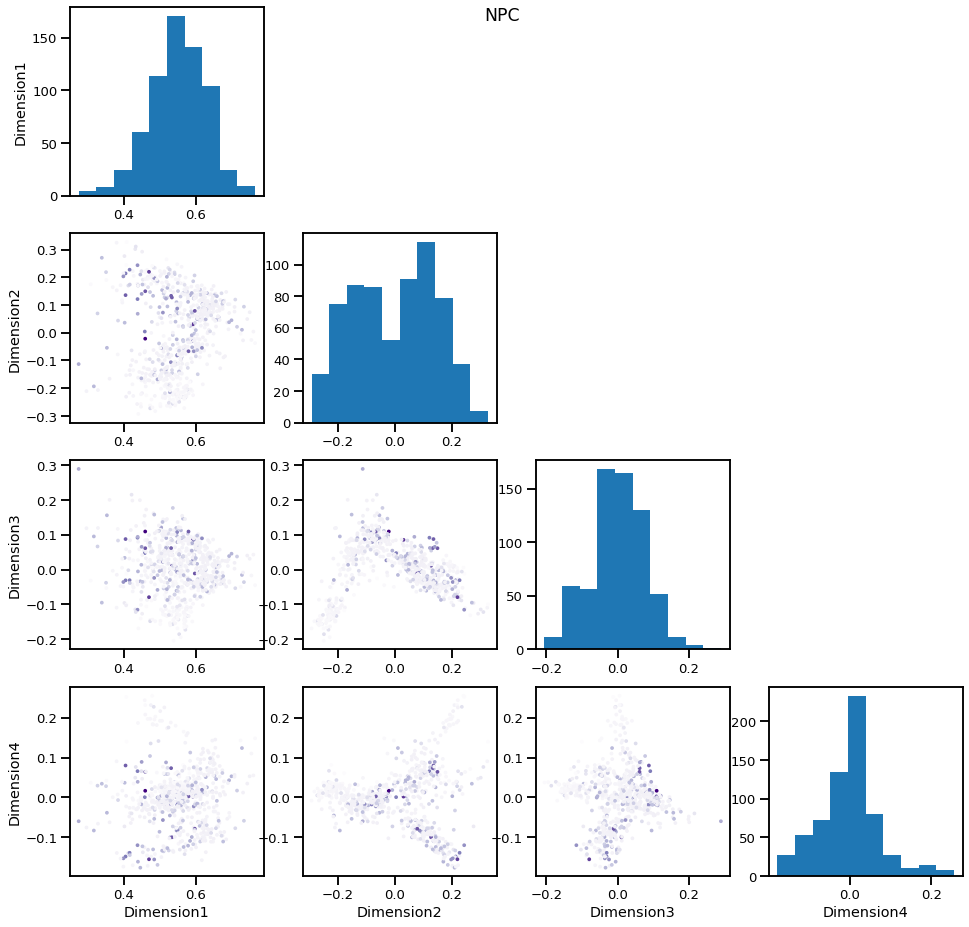

In [12]:
cell_type_id = 2
expn = np.sum(residuals[:,feature_id[cell_type_id]], axis=1)

fig,axs = plt.subplots(n_dim, n_dim,figsize=(n_dim*4, n_dim*4))
for i in range(n_dim):
    for j in range(n_dim):
        ax = axs[i,j]
        if j > i:
            ax.axis('off')
        else:
            if j == i:
                ax.hist(embedding[:,i])
            else:
                ax.scatter(embedding[:,j], embedding[:,i], s=5, cmap=colors[cell_type_id],
                    c=expn)
            if i == n_dim - 1:
                ax.set_xlabel('Dimension'+str(j+1))
            if j == 0:
                ax.set_ylabel('Dimension'+str(i+1))
plt.suptitle(cell_types[cell_type_id], y=0.88)
plt.show()


 ## Automatic Gaussian mixture modeling

In [13]:
agg = AutoGMMCluster()
pred = agg.fit_predict(embedding)


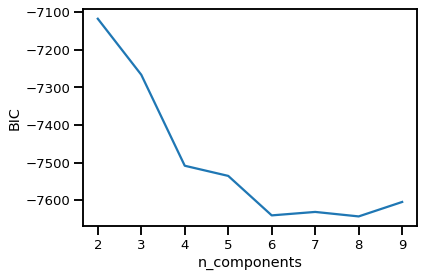

In [14]:
r = agg.results_
n_components = range(2, 10)
bics = [r[r['n_components']==n]['bic/aic'].min() for n in n_components]
fig, ax = plt.subplots(1)
ax.plot(n_components, bics)
ax.set(xlabel='n_components', ylabel='BIC')
plt.show()


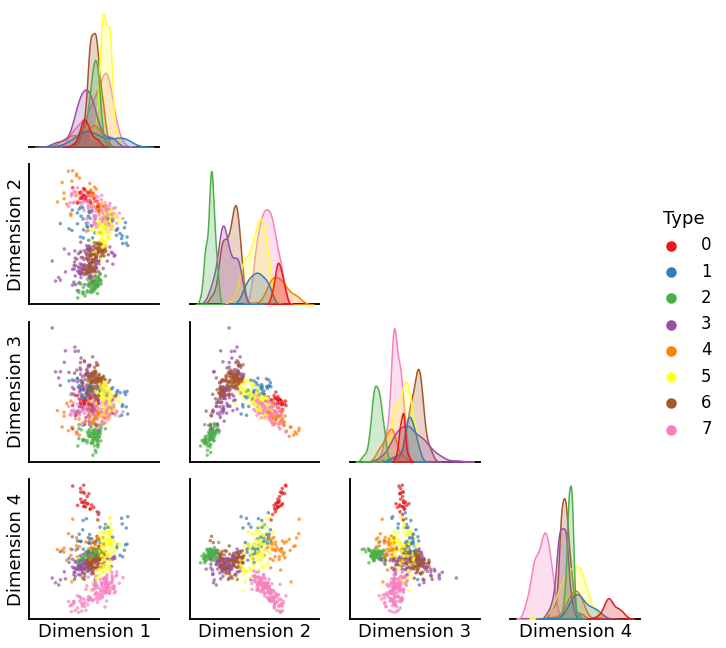

In [15]:
pairplot(embedding, pred)
plt.show()
